# **Implementacion de modelos de regresion**

Supongamos que se quiere predecir para las siguientes 24 horas

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import statsmodels.api as sm

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import Lasso, Ridge
from sklearn.pipeline import Pipeline

from statsmodels.stats.diagnostic import acorr_ljungbox
from scipy.stats import jarque_bera
from scipy.stats import jarque_bera

In [2]:
data_pm10=pd.read_csv("C:/Users/fonta/OneDrive/Documentos/CDD/6. Sexto semestre/Machine learning/Proyecto final/seriepm10.csv")

In [3]:
data_pm10.head()

,fecha,pm10
0,2017-01-01 00:59:59+00:00,61.9
1,2017-01-01 01:59:59+00:00,101.0
2,2017-01-01 02:59:59+00:00,75.6
3,2017-01-01 03:59:59+00:00,56.3
4,2017-01-01 04:59:59+00:00,107.1


In [4]:
data_pm10['pm10_lag1'] = data_pm10['pm10'].shift(1)  # Un retraso
data_pm10['pm10_lag2'] = data_pm10['pm10'].shift(2)  # Dos retrasos
data_pm10['pm10_lag3'] = data_pm10['pm10'].shift(3)
data_pm10['pm10_lag4'] = data_pm10['pm10'].shift(4) 
data_pm10['pm10_lag5'] = data_pm10['pm10'].shift(5)  
data_pm10 = data_pm10.dropna()  # Eliminar las filas con valores NaN causados por los shifts

X = data_pm10[['pm10_lag1', 'pm10_lag2','pm10_lag3','pm10_lag4','pm10_lag5']]
y = data_pm10['pm10']

In [5]:
data_pm10.head()

,fecha,pm10,pm10_lag1,pm10_lag2,pm10_lag3,pm10_lag4,pm10_lag5
5,2017-01-01 05:59:59+00:00,92.1,107.1,56.3,75.6,101.0,61.9
6,2017-01-01 06:59:59+00:00,82.5,92.1,107.1,56.3,75.6,101.0
7,2017-01-01 07:59:59+00:00,55.3,82.5,92.1,107.1,56.3,75.6
8,2017-01-01 08:59:59+00:00,72.6,55.3,82.5,92.1,107.1,56.3
9,2017-01-01 09:59:59+00:00,49.3,72.6,55.3,82.5,92.1,107.1


## **K-NN**

A continuación se realiza un GridSearch con validación cruzada para nuestros datos tomados a traves del tiempo para así hallar el mejor parametro k para nuestro modelo K-NN para predecir la particula de Pm10 en la estación Ermita.

In [6]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),   
    ('knn', KNeighborsRegressor()) 
])

tscv = TimeSeriesSplit(n_splits=5)

param_grid = {
    'knn__n_neighbors': [3,5,7,10,15,20,30]
}

grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

grid_search.fit(X, y)

# Imprimir los mejores parámetros
print("Mejores parámetros:", grid_search.best_params_)
print("Score de entrenamineto:", grid_search.best_score_)

predicc_knn = grid_search.predict(X)

#residuos
residuos_knn = y - predicc_knn

Mejores parámetros: {'knn__n_neighbors': 30}
Score de entrenamineto: 0.5648043586722304


Como resultado, obtendremos que el mejor parámetro es $k=30$, el cual es el parámetro con el cual se obtiene el mejor score en el conjunto de entrenamiento. La métrica utilizada fue $r^2$. Así, para el parámetro $k=30$ se obtuvo un $r^2=0.5648%$, sabemos que este score no es el mejor ni el más adecuado, puesto que indica que el modelo k-nn solo alcanza a explicar la variabilidad de los datos en un 56%.

### **Errores y métricas**

En segundo lugar pasamos a evaluar las métricas y errores de nuestro modelo, estas nos ayudan a saber un poco mas a detalle como se comporta al momento de predecir los datos, estos errores son medidos por la diferencia entre lo observado y lo predicho, como es un modelo de regresión las métricas evaluadas seran el $MAE$, $MSE$, $RMSE$, $R2$.

In [7]:
mae = mean_absolute_error(y, predicc_knn)
mse = mean_squared_error(y, predicc_knn)
rmse = np.sqrt(mse)
r2 = r2_score(y, predicc_knn)

tabla1 = pd.DataFrame({
    '': 'K-NN',
    'MAE': [mae],
    'MSE':[mse],
    'RMSE':[rmse],
    'r2':[r2]
})

tabla1

,,MAE,MSE,RMSE,r2
0,K-NN,9.717867,186.206472,13.645749,0.598803


Con la tabla anterior podemos hacer la interpretación de las métricas para el modelo K-NN con parametro $k=30$. El valor de r2 indica que el modelo captura una parte significativa de la variabilidad de los datos, pero aún hay margen de mejora, ademas el MSE es relativamente alto sugiriendo que el modelo tiene dificultades para predecir correctamente los valores extremos y El MAE indica que, en promedio, las predicciones del modelo están bastante lejos de los valores reales.

### **Pruebas analíticas de los residuos**

Tambien es importante verificar que se cumplen los supuestos del modelo, siendo los mas importantes el supuesto de independencia y de normalidad, lo veremos a continuación.

#### ***Independencia***

Recordemos las hipotesis para la prueba de independencia **Ljung-Box**

$H_0= \textit{Los residuos no estan correlacionados}$

$H_1= \textit{Los residuos estan correlacionados}$

In [8]:
ljung_box_results = acorr_ljungbox(residuos_knn, lags=[10], return_df=True)
print("Ljung-Box test p-valor:", ljung_box_results['lb_pvalue'].values[0])

tabla1['Ljung-Box']=ljung_box_results['lb_pvalue'].values[0]

Ljung-Box test p-valor: 4.894530355915035e-34


La prueba arrojó un p-valor menor a 0.05 en la prueba de Ljung-Box lo que implica que los residuos estan correlacionados, es decir, existe algún tipo de estructura o patrón en los residuos que sugiere dependencia entre los mismos.

#### ***Normalidad***

Recordemos las hipotesis para la prueba de independencia **Jarque_bera**


$H_0= \textit{Los residuos no son normales}$

$H_1= \textit{Los residuos son normales}$

In [9]:
jb_stat, jb_p_value = jarque_bera(residuos_knn)
print("Jarque-Bera test p-valor:", jb_p_value)

tabla1['Jarque-Bera']=jb_p_value

Jarque-Bera test p-valor: 0.0


Con el resulatado de la prueba de Jarque_bera podemos concluir que los residuos del modelo son normales, por lo cual se cumple el supuesto de normalidad con un p-valor=0

#### ***Gráficos de los supuestos.***

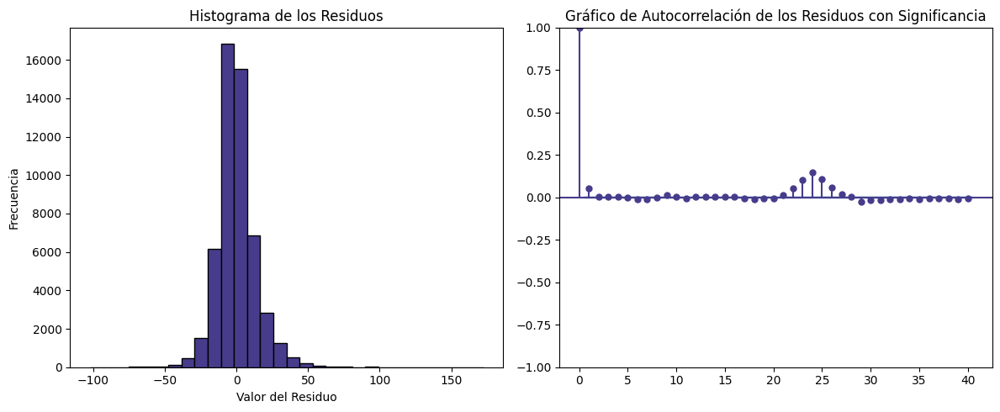

In [10]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histograma de los residuos
axes[0].hist(residuos_knn, bins=30, color='#473C8B', edgecolor='black')
axes[0].set_title("Histograma de los Residuos")
axes[0].set_xlabel("Valor del Residuo")
axes[0].set_ylabel("Frecuencia")

# Gráfico de autocorrelación con significancia
sm.graphics.tsa.plot_acf(residuos_knn, lags=40, ax=axes[1], color='#473C8B', vlines_kwargs={'color': '#473C8B'}, alpha=0.05)

axes[1].set_title("Gráfico de Autocorrelación de los Residuos con Significancia")

# Mostrar el grid de gráficos
plt.tight_layout()
plt.show()

### **Gráfica: Obervado VS Predicho**

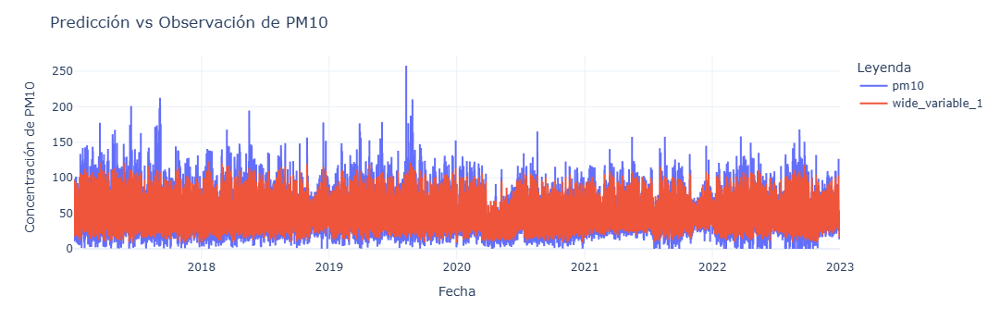

In [11]:
fig = px.line(data_pm10, x='fecha', y=[y, predicc_knn], 
              labels={'value': 'PM10', 'variable': 'Leyenda'})

# Personalizar el estilo de las líneas
fig.update_traces(line=dict(width=2))  # Grosor de las líneas
fig.update_traces(line_color='#473C8B', selector=dict(name='pm10_observado'))  # Color de la línea observada
fig.update_traces(line=dict(dash='dash'), selector=dict(name='pm10_predicho'))  # Estilo de línea discontinua para las predicciones

# Personalizar el layout
fig.update_layout(
    title='Predicción vs Observación de PM10',
    xaxis_title='Fecha',
    yaxis_title='Concentración de PM10',
    legend_title='Leyenda',
    template='plotly_white',  # Cambia el estilo del fondo
    hovermode='x unified'  # Muestra información de todas las líneas al pasar el ratón
)

# Mostrar la gráfica
fig.show()

## **Lasso**

La misma lógica que se aplico en el modelo anterior será usada para la regresión Lasso, para así hallar el mejor parametro de reguralización $\alpha$.

In [12]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),   
    ('lasso', Lasso()) 
])
tscv = TimeSeriesSplit(n_splits=5)

param_grid = {
    'lasso__alpha': [0.001, 0.01, 0.1, 1.0, 10.0] 
}

grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

grid_search.fit(X, y)

print("Mejores parámetros:", grid_search.best_params_)
print("Score de entrenamiento:", grid_search.best_score_)

predicc_lasso = grid_search.predict(X)

# Calcular los residuos
residuos_lasso = y - predicc_lasso


Mejores parámetros: {'lasso__alpha': 0.01}
Score de entrenamiento: 0.5649782914088946


Obtuvimos como resultado que de todos los posibles parametros de $\alpha$ el que nos entrega el mejor score siendo este de 56.49% es el $\alpha = 0.01$. Podemos ver que este score en el conjunto de entrenamiento no es muy distante del que se obtuvo con el modelo anterior.

### **Errores y métricas**

Podemos ahora análisar las métricas para el modelo de regresion Lasso.

In [13]:
mae = mean_absolute_error(y, predicc_lasso)
mse = mean_squared_error(y, predicc_lasso)
rmse = np.sqrt(mse)
r2 = r2_score(y, predicc_lasso)

tabla2 = pd.DataFrame({
    '': 'Lasso',
    'MAE': [mae],
    'MSE':[mse],
    'RMSE':[rmse],
    'r2':[r2]
})

tabla2

,,MAE,MSE,RMSE,r2
0,Lasso,10.068336,203.764545,14.274612,0.560972


Con los resultados anteriores podemos decir que ll modelo Lasso ha logrado explicar una parte significativa de la variabilidad en los datos($r^2$=0.5609), pero aún presenta un margen de error considerable puesto que por los errores son relativamente grande.

### **Pruebas analíticas de los residuos**

#### ***Independencia***

In [14]:
ljung_box_results = acorr_ljungbox(residuos_lasso, lags=[10], return_df=True)
print("Ljung-Box test p-valor:", ljung_box_results['lb_pvalue'].values[0])

tabla2['Ljung-Box']=ljung_box_results['lb_pvalue'].values[0]

Ljung-Box test p-valor: 0.3478560122028262


Vemos que con un p-valor de 0.34, podemos quedarnos con la hipotesis nula de la prueba Ljung-Box, por lo tanto para un nivel de significancia del 5%, los residuos del modelo Lasso son independientes.

#### ***Normalidad***

In [15]:
jb_stat, jb_p_value = jarque_bera(residuos_lasso)
print("Jarque-Bera test p-valor:", jb_p_value) #normalidad

tabla2['Jarque-Bera']=jb_p_value

Jarque-Bera test p-valor: 0.0


Con el p-valor obtenido en la prueba de normalidad para los residuos del modelo Lasso podemos concluir que estos resiuos son normales.

#### ***Gráficos de los supuestos***

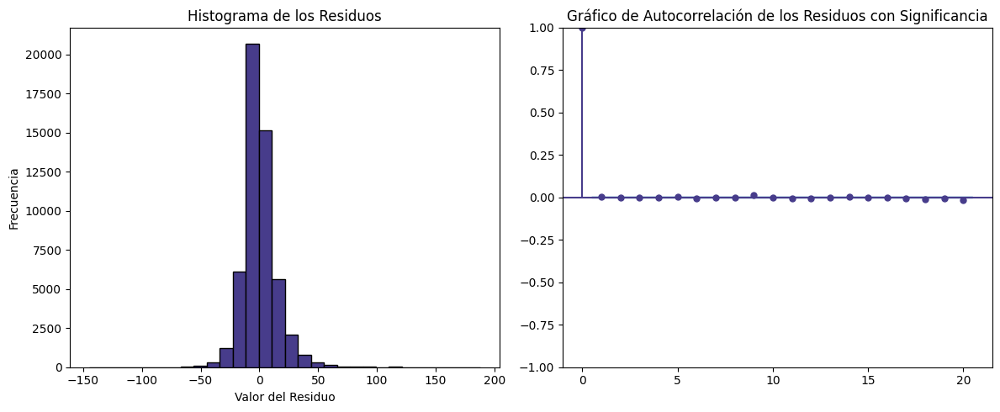

In [16]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histograma de los residuos
axes[0].hist(residuos_lasso, bins=30, color='#473C8B', edgecolor='black')
axes[0].set_title("Histograma de los Residuos")
axes[0].set_xlabel("Valor del Residuo")
axes[0].set_ylabel("Frecuencia")

# Gráfico de autocorrelación con significancia
sm.graphics.tsa.plot_acf(residuos_lasso, lags=20, ax=axes[1], color='#473C8B', vlines_kwargs={'color': '#473C8B'}, alpha=0.05)

axes[1].set_title("Gráfico de Autocorrelación de los Residuos con Significancia")

# Mostrar el grid de gráficos
plt.tight_layout()
plt.show()

### **Gráfica: Obervado VS Predicho**

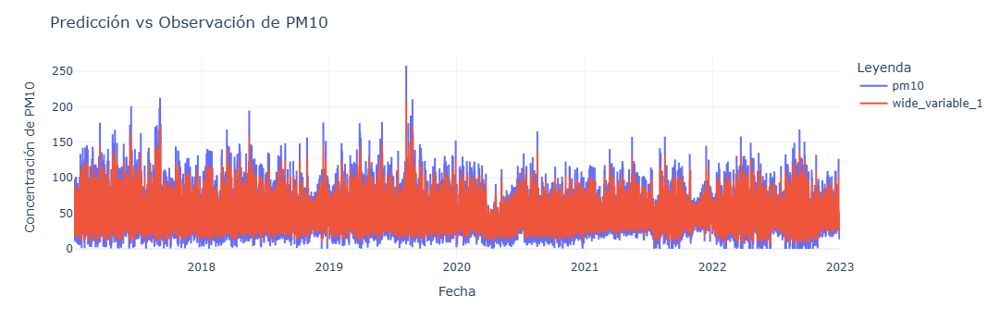

In [17]:
fig = px.line(data_pm10, x='fecha', y=[y, predicc_lasso], 
              labels={'value': 'PM10', 'variable': 'Leyenda'})

# Personalizar el estilo de las líneas
fig.update_traces(line=dict(width=2))  # Grosor de las líneas
fig.update_traces(line_color='#473C8B', selector=dict(name='pm10_observado'))  # Color de la línea observada
fig.update_traces(line=dict(dash='dash'), selector=dict(name='pm10_predicho'))  # Estilo de línea discontinua para las predicciones

# Personalizar el layout
fig.update_layout(
    title='Predicción vs Observación de PM10',
    xaxis_title='Fecha',
    yaxis_title='Concentración de PM10',
    legend_title='Leyenda',
    template='plotly_white',  # Cambia el estilo del fondo
    hovermode='x unified'  # Muestra información de todas las líneas al pasar el ratón
)

# Mostrar la gráfica
fig.show()

## **Ridge**

In [18]:

pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('ridge', Ridge()) 
])
tscv = TimeSeriesSplit(n_splits=5)

param_grid = {
    'ridge__alpha': [0.001, 0.01, 0.1, 1.0, 10.0, 100.0]  
}

grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

grid_search.fit(X, y)

print("Mejores parámetros:", grid_search.best_params_)
print("Score de entrenamiento:", grid_search.best_score_)

predicc_ridge = grid_search.predict(X)

# Calcular los residuos
residuos_ridge = y - predicc_ridge


Mejores parámetros: {'ridge__alpha': 0.001}
Score de entrenamiento: 0.5649771137261234


En este caso para la regresion Ridge encontramos que el parametro de regularización que entrega le mejor score en el conjunto de entrenamiento es $\alpha = 0.001$, el score en el entrenamiento es de 56.49% que si recordamos es igual al de la regresion Lasso.

### **Errores y métricas**

Pasemos acontinuacióna análisar el rendimiento del modelo en terminos de sus métricas de error.

In [19]:
mae = mean_absolute_error(y, predicc_ridge)
mse = mean_squared_error(y, predicc_ridge)
rmse = np.sqrt(mse)
r2 = r2_score(y, predicc_ridge)

tabla3 = pd.DataFrame({
    '': 'Ridge',
    'MAE': [mae],
    'MSE':[mse],
    'RMSE':[rmse],
    'r2':[r2]
})

tabla3

,,MAE,MSE,RMSE,r2
0,Ridge,10.067056,203.763002,14.274558,0.560976


Vemos que estas métricas no son muy diferentes a las anteriores, este modelo explica la variabilidad de los datos en un 56.09%.

### **Pruebas analíticas de los residuos.**

#### ***Independencia***

In [20]:
ljung_box_results = acorr_ljungbox(residuos_ridge, lags=[10], return_df=True)
print("Ljung-Box test p-valor:", ljung_box_results['lb_pvalue'].values[0])

tabla3['Ljung-Box']=ljung_box_results['lb_pvalue'].values[0]

Ljung-Box test p-valor: 0.3891170230078263


Con el p-valor obtenido en la prueba analítica para la independencia de los residuos, no se rechasa la hipotesis nula, por lo tanto los residuos cumplen con el supuesto de independencia.

#### ***Normaildad***

In [21]:
jb_stat, jb_p_value = jarque_bera(residuos_ridge)
print("Jarque-Bera test p-valor:", jb_p_value)

tabla3['Jarque-Bera']=jb_p_value

Jarque-Bera test p-valor: 0.0


Se comprueba de esta forma que los residuos de la regresion ridge tambien son normales.

#### ***Gráficos de los supuestos***

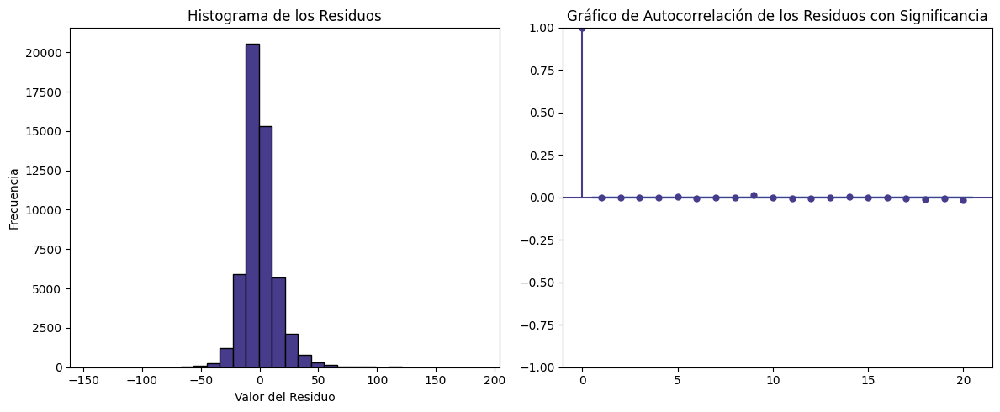

In [22]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histograma de los residuos
axes[0].hist(residuos_ridge, bins=30, color='#473C8B', edgecolor='black')
axes[0].set_title("Histograma de los Residuos")
axes[0].set_xlabel("Valor del Residuo")
axes[0].set_ylabel("Frecuencia")

# Gráfico de autocorrelación con significancia
sm.graphics.tsa.plot_acf(residuos_ridge, lags=20, ax=axes[1], color='#473C8B', vlines_kwargs={'color': '#473C8B'}, alpha=0.05)

axes[1].set_title("Gráfico de Autocorrelación de los Residuos con Significancia")

# Mostrar el grid de gráficos
plt.tight_layout()
plt.show()

### **Gráfica: Predicho VS Observado**

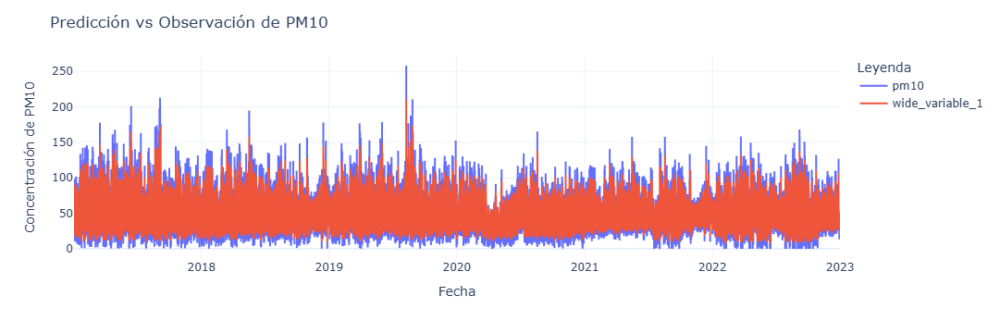

In [23]:
fig = px.line(data_pm10, x='fecha', y=[y, predicc_ridge], 
              labels={'value': 'PM10', 'variable': 'Leyenda'})

# Personalizar el estilo de las líneas
fig.update_traces(line=dict(width=2))  # Grosor de las líneas
fig.update_traces(line_color='#473C8B', selector=dict(name='pm10_observado'))  # Color de la línea observada
fig.update_traces(line=dict(dash='dash'), selector=dict(name='pm10_predicho'))  # Estilo de línea discontinua para las predicciones

# Personalizar el layout
fig.update_layout(
    title='Predicción vs Observación de PM10',
    xaxis_title='Fecha',
    yaxis_title='Concentración de PM10',
    legend_title='Leyenda',
    template='plotly_white',  # Cambia el estilo del fondo
    hovermode='x unified'  # Muestra información de todas las líneas al pasar el ratón
)

# Mostrar la gráfica
fig.show()

## **Comparación**

Luego de implementar cada uno de los modelos que nos podrían ayudar a predecir mejor la particula del PM-10 en la estación ermita debemos escoger cual es el mejor de los modelos antes implentados, veamos:

In [24]:
modelos=pd.concat([tabla1,tabla2,tabla3])
modelos

,,MAE,MSE,RMSE,r2,Ljung-Box,Jarque-Bera
0,K-NN,9.717867,186.206472,13.645749,0.598803,4.894530e-34,0.0
0,Lasso,10.068336,203.764545,14.274612,0.560972,3.478560e-01,0.0
0,Ridge,10.067056,203.763002,14.274558,0.560976,3.891170e-01,0.0


**Conclusión:** Si conparamos cada uno de los modelos, basandonos en los valores que obtuvieron para cada métrica, podríamos decir que el mejor modelo es el K-nn. Puesto que este tiene los errores más bajos y el $r2$ más alto, pero esta decisión se pondría en duda puesto que este modelo, como lo dijimos antes, no cumple con el supuesto de independencia en los residuos y este supuesto es muy importante para decidir cual es el mejor modelo. Por otro lado, tenemos las regresiones Ridge y Lasso; sus métricas son muy parecidas y ambos cumplen con los supuestos, así que siguiendo nos de esto, de los 3 modelos que fueron implementados se debería elegir entre la regresión Ridge y Lasso, pero teniendo en cuenta que la captura de la variabilidad de los datos, es decir, el $r^2$ es moderada y sus errores medios, relativamente grandes.